In [5]:
import pandas as pd
import glob
import os

def merge_excel_files(input_directory, output_file, column_names):
    """
    Une todos os arquivos .xlsx em um diretório com as mesmas colunas em um único arquivo .xlsx,
    ordenando os dados pela coluna 'scan: Scan Count'.

    :param input_directory: Caminho para o diretório contendo arquivos .xlsx
    :param output_file: Caminho para o arquivo de saída .xlsx
    :param column_names: Lista de nomes das colunas esperadas nos arquivos .xlsx
    """
    # Verifica se o diretório existe
    if not os.path.isdir(input_directory):
        print(f"O diretório {input_directory} não existe.")
        return

    # Encontrar todos os arquivos .xlsx no diretório
    excel_files = glob.glob(os.path.join(input_directory, '*.xlsx'))

    # Verificar se algum arquivo .xlsx foi encontrado
    if not excel_files:
        print("Nenhum arquivo .xlsx encontrado no diretório especificado.")
        return

    print(f"Arquivos encontrados: {excel_files}")

    # Lista para armazenar os DataFrames
    dataframes = []

    for file in excel_files:
        print(f"Lendo o arquivo {file}")
        try:
            # Ler o arquivo .xlsx com as colunas especificadas
            df = pd.read_excel(file, usecols=column_names)
            # Adicionar o DataFrame à lista
            dataframes.append(df)
        except Exception as e:
            print(f"Erro ao ler o arquivo {file}: {e}")

    if not dataframes:
        print("Nenhum arquivo .xlsx foi lido com sucesso.")
        return

    # Concatenar todos os DataFrames em um único DataFrame
    combined_df = pd.concat(dataframes, ignore_index=True)

    # Ordenar o DataFrame pela coluna 'scan: Scan Count'
    combined_df.sort_values(by='scan: Scan Count', inplace=True)

    # Salvar o DataFrame combinado em um novo arquivo .xlsx
    try:
        combined_df.to_excel(output_file, index=False)
        print(f"Arquivo combinado e ordenado salvo em {output_file}")
    except Exception as e:
        print(f"Erro ao salvar o arquivo combinado: {e}")

# Lista de nomes das colunas esperadas
column_names = [
    'scan: Scan Count', 'timeJ: Julian Days', 'prDM: Pressure, Digiquartz [db]',
    'depSM: Depth [salt water, m]', 't090C: Temperature [ITS-90, deg C]', 
    't190C: Temperature, 2 [ITS-90, deg C]', 'c0S/m: Conductivity [S/m]',
    'c1S/m: Conductivity, 2 [S/m]', 'sbeox0ML/L: Oxygen, SBE 43 [ml/l]',
    'sbeox1ML/L: Oxygen, SBE 43, 2 [ml/l]', 'sal00: Salinity [PSU]', 
    'sal11: Salinity, 2 [PSU]', 'flSP: Fluorescence, Seapoint',
    'latitude: Latitude [deg]', 'longitude: Longitude [deg]',
    'dz/dtM: Descent Rate [m/s]', 'depSM: Depth [salt water, m]',
    'potemp090C: Potential Temperature [ITS-90, deg C]',
    'potemp190C: Potential Temperature, 2 [ITS-90, deg C]',
    'sal00: Salinity [PSU]', 'sal11: Salinity, 2 [PSU]',
    'density00: Density [density, Kg/m^3]', 'density11: Density, 2 [density, Kg/m^3]',
    'sigma-θ00: Density [sigma-theta, Kg/m^3]', 'sigma-θ11: Density, 2 [sigma-theta, Kg/m^3]',
    'oxsatML/L: Oxygen Saturation [ml/l]', 'svCM: Sound Velocity [Chen-Millero, m/s]',
    'flag'
]

# Exemplo de uso
input_directory = './'  # Substitua pelo seu diretório
output_file = 'arquivo_combinado.xlsx'  # Nome do arquivo de saída
merge_excel_files(input_directory, output_file, column_names)


Arquivos encontrados: ['.\\arquivo_combinado.xlsx', '.\\dOP38_001.xlsx', '.\\dOP38_002.xlsx', '.\\dOP38_003.xlsx', '.\\dOP38_004.xlsx', '.\\dOP38_005.xlsx', '.\\dOP38_006.xlsx', '.\\dOP38_007.xlsx', '.\\dOP38_008.xlsx', '.\\dOP38_009.xlsx', '.\\dOP38_010.xlsx', '.\\dOP38_011.xlsx', '.\\dOP38_012.xlsx', '.\\dOP38_013.xlsx', '.\\dOP38_014.xlsx', '.\\dOP38_015.xlsx', '.\\dOP38_016.xlsx', '.\\dOP38_017.xlsx', '.\\dOP38_019.xlsx', '.\\dOP38_020.xlsx', '.\\dOP38_021.xlsx', '.\\dOP38_023.xlsx', '.\\dOP38_024.xlsx', '.\\possiveis_manchas_petroleo.xlsx']
Lendo o arquivo .\arquivo_combinado.xlsx
Lendo o arquivo .\dOP38_001.xlsx
Lendo o arquivo .\dOP38_002.xlsx
Lendo o arquivo .\dOP38_003.xlsx
Lendo o arquivo .\dOP38_004.xlsx
Lendo o arquivo .\dOP38_005.xlsx
Lendo o arquivo .\dOP38_006.xlsx
Lendo o arquivo .\dOP38_007.xlsx
Lendo o arquivo .\dOP38_008.xlsx
Lendo o arquivo .\dOP38_009.xlsx
Lendo o arquivo .\dOP38_010.xlsx
Lendo o arquivo .\dOP38_011.xlsx
Lendo o arquivo .\dOP38_012.xlsx
Lendo o arq

In [6]:
!pip install folium

In [7]:
import pandas as pd

def read_cnv_file(file_path, output_excel_path):
    """
    Lê um arquivo .cnv e o converte em um DataFrame pandas com colunas nomeadas.
    Salva o DataFrame resultante em um arquivo Excel sem incluir o índice.
    
    :param file_path: Caminho para o arquivo .cnv.
    :param output_excel_path: Caminho para o arquivo Excel de saída.
    """
    column_names = [
        'scan: Scan Count', 'timeJ: Julian Days', 'prDM: Pressure, Digiquartz [db]',
        'depSM: Depth [salt water, m]', 't090C: Temperature [ITS-90, deg C]', 
        't190C: Temperature, 2 [ITS-90, deg C]', 'c0S/m: Conductivity [S/m]',
        'c1S/m: Conductivity, 2 [S/m]', 'sbeox0ML/L: Oxygen, SBE 43 [ml/l]',
        'sbeox1ML/L: Oxygen, SBE 43, 2 [ml/l]', 'sal00: Salinity [PSU]', 
        'sal11: Salinity, 2 [PSU]', 'flSP: Fluorescence, Seapoint',
        'latitude: Latitude [deg]', 'longitude: Longitude [deg]',
        'dz/dtM: Descent Rate [m/s]', 'depSM: Depth [salt water, m]',
        'potemp090C: Potential Temperature [ITS-90, deg C]',
        'potemp190C: Potential Temperature, 2 [ITS-90, deg C]',
        'sal00: Salinity [PSU]', 'sal11: Salinity, 2 [PSU]',
        'density00: Density [density, Kg/m^3]', 'density11: Density, 2 [density, Kg/m^3]',
        'sigma-θ00: Density [sigma-theta, Kg/m^3]', 'sigma-θ11: Density, 2 [sigma-theta, Kg/m^3]',
        'oxsatML/L: Oxygen Saturation [ml/l]', 'svCM: Sound Velocity [Chen-Millero, m/s]',
        'flag'
    ]

    try:
 
        df = pd.read_csv(file_path, delim_whitespace=True, comment='#', header=None, dtype=float)
        pd.set_option('display.float_format', '{:.16f}'.format)
        df.to_excel(output_excel_path, index=False, float_format='%.6f')
    
        if len(df.columns) != len(column_names):
            raise ValueError(f"Esperado {len(column_names)} colunas, mas encontrado {len(df.columns)} colunas no arquivo.")
        
        df.columns = column_names
        
        print("Arquivo carregado com sucesso!")
        
        with pd.option_context('display.max_rows', None, 'display.max_columns', None):
            print(df)

        df.to_excel(output_excel_path, index=False, float_format='%.6f')
        print(f"Arquivo Excel salvo com sucesso em: {output_excel_path}")
        
        return df
    except Exception as e:
        print(f"Ocorreu um erro ao ler o arquivo: {e}")
        return None

file_path = 'dOP38_024.cnv'
output_excel_path = 'dOP38_024.xlsx'
dataframe = read_cnv_file(file_path, output_excel_path)


Arquivo carregado com sucesso!
         scan: Scan Count   timeJ: Julian Days  \
0    621.0000000000000000 326.8309130000000096   
1    659.0000000000000000 326.8309310000000210   
2    694.0000000000000000 326.8309469999999806   
3    727.0000000000000000 326.8309629999999970   
4    760.0000000000000000 326.8309790000000135   
5    796.0000000000000000 326.8309970000000249   
6    832.0000000000000000 326.8310139999999819   
7    864.0000000000000000 326.8310299999999984   
8    894.0000000000000000 326.8310440000000199   
9    927.0000000000000000 326.8310599999999795   
10   960.0000000000000000 326.8310759999999959   
11   991.0000000000000000 326.8310910000000149   
12  1020.0000000000000000 326.8311049999999796   
13  1051.0000000000000000 326.8311199999999985   
14  1082.0000000000000000 326.8311350000000175   
15  1114.0000000000000000 326.8311499999999796   
16  1146.0000000000000000 326.8311659999999961   
17  1179.0000000000000000 326.8311810000000150   
18  1211.0000000000

C:\Users\Indicium\AppData\Local\Temp\ipykernel_26008\2031921420.py:23: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


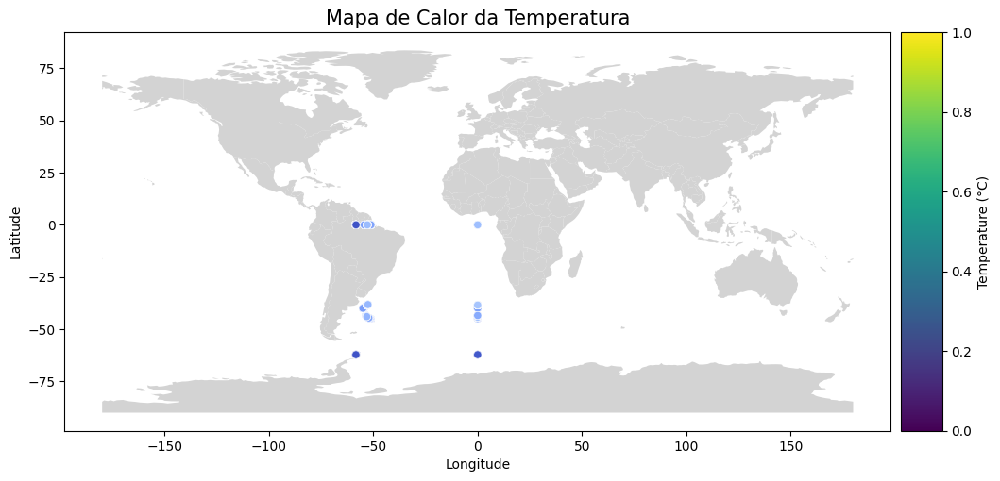

In [10]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import seaborn as sns
from mpl_toolkits.axes_grid1 import make_axes_locatable

def plot_heatmap(file_path):
    """
    Lê um arquivo CSV com dados de temperatura e localização, e plota um mapa de calor.
    
    :param file_path: Caminho para o arquivo CSV com dados.
    """
    try:
        # Carrega os dados do CSV
        df = pd.read_excel(file_path)
        
        # Converte para um GeoDataFrame
        gdf = gpd.GeoDataFrame(df, 
                               geometry=gpd.points_from_xy(df['longitude: Longitude [deg]'], df['latitude: Latitude [deg]']),
                               crs='EPSG:4326')
        
        # Carrega um mapa base do mundo
        world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

        # Cria o gráfico
        fig, ax = plt.subplots(1, 1, figsize=(12, 8))
        
        # Plota o mapa base
        world.plot(ax=ax, color='lightgrey')
        
        # Plota os dados de temperatura como um mapa de calor
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="5%", pad=0.1)
        
        # Mapa de calor usando seaborn
        sns.scatterplot(data=df, x='longitude: Longitude [deg]', y='latitude: Latitude [deg]', 
                        hue='t090C: Temperature [ITS-90, deg C]', palette='coolwarm', alpha=0.7, ax=ax, legend=False)
        
        plt.colorbar(ax.collections[0], cax=cax, label='Temperature (°C)')
        
        # Adiciona títulos e rótulos
        ax.set_title('Mapa de Calor da Temperatura', fontsize=15)
        ax.set_xlabel('Longitude')
        ax.set_ylabel('Latitude')
        
        # Mostra o gráfico
        plt.show()
        
    except Exception as e:
        print(f"Ocorreu um erro ao processar o arquivo: {e}")

# Exemplo de uso
file_path = 'arquivo_combinado.xlsx'
plot_heatmap(file_path)


C:\Users\Indicium\AppData\Local\Temp\ipykernel_26008\24496718.py:28: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


Ocorreu um erro ao processar o arquivo: 'Axes' object has no attribute 'get_array'


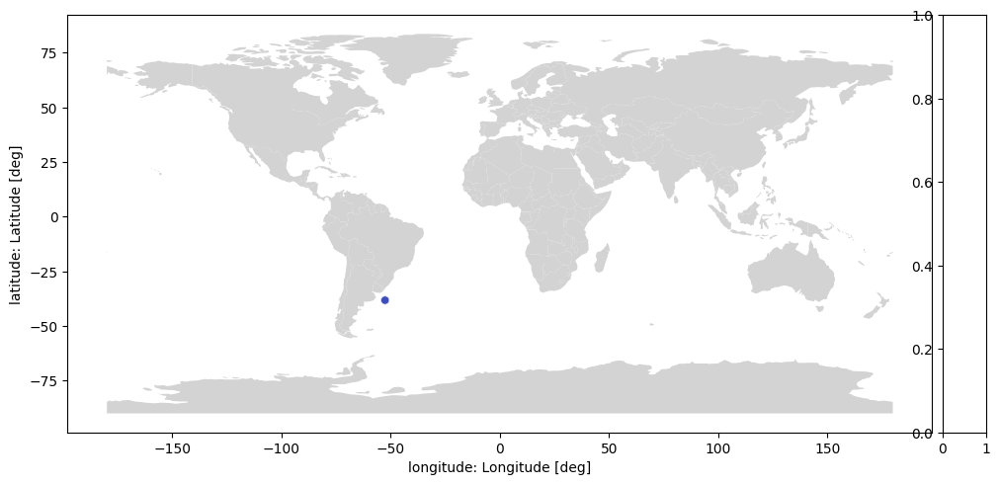

In [11]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import seaborn as sns
from mpl_toolkits.axes_grid1 import make_axes_locatable

def plot_heatmap(file_path, lat_min, lat_max, lon_min, lon_max):
    """
    Lê um arquivo CSV com dados de temperatura e localização, e plota um mapa de calor
    em uma região específica.
    
    :param file_path: Caminho para o arquivo CSV com dados.
    :param lat_min: Latitude mínima para o recorte.
    :param lat_max: Latitude máxima para o recorte.
    :param lon_min: Longitude mínima para o recorte.
    :param lon_max: Longitude máxima para o recorte.
    """
    try:
        # Carrega os dados do CSV
        df = pd.read_excel(file_path)
        
        # Converte para um GeoDataFrame
        gdf = gpd.GeoDataFrame(df, 
                               geometry=gpd.points_from_xy(df['longitude: Longitude [deg]'], df['latitude: Latitude [deg]']),
                               crs='EPSG:4326')
        
        # Carrega um mapa base do mundo
        world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
        
        # Define o recorte
        bbox = gdf.cx[lon_min:lon_max, lat_min:lat_max]
        
        # Cria o gráfico
        fig, ax = plt.subplots(1, 1, figsize=(12, 8))
        
        # Plota o mapa base
        world.plot(ax=ax, color='lightgrey')
        
        # Plota os dados de temperatura como um mapa de calor
        scatter = sns.scatterplot(data=gdf, x='longitude: Longitude [deg]', y='latitude: Latitude [deg]', 
                                  hue='t090C: Temperature [ITS-90, deg C]', palette='coolwarm', alpha=0.7, ax=ax, legend=False)
        
        # Adiciona barra de cores
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="5%", pad=0.1)
        plt.colorbar(scatter, cax=cax, label='Temperature (°C)')
        
        # Define os limites do mapa
        ax.set_xlim(lon_min, lon_max)
        ax.set_ylim(lat_min, lat_max)
        
        # Adiciona títulos e rótulos
        ax.set_title('Mapa de Calor da Temperatura', fontsize=15)
        ax.set_xlabel('Longitude')
        ax.set_ylabel('Latitude')
        
        # Mostra o gráfico
        plt.show()
        
    except Exception as e:
        print(f"Ocorreu um erro ao processar o arquivo: {e}")

# Exemplo de uso
file_path = 'dOP38_001.xlsx'

# Defina os limites do recorte
lat_min, lat_max = -10, 10
lon_min, lon_max = -70, -50

plot_heatmap(file_path, lat_min, lat_max, lon_min, lon_max)


Objetivo no Contexto do Projeto:
O mapa de calor gerado por este código serve para visualizar a distribuição espacial da temperatura em uma região específica do Atlântico Sudoeste, conforme coletado durante a operação antártica. A análise espacial da temperatura é crucial para compreender padrões térmicos, identificar áreas de interesse e correlacionar essas variações com outros parâmetros oceanográficos (como salinidade e densidade) e eventos ambientais.

Possíveis Melhorias:
Integração com Dados Adicionais:

Dados de Salinidade e Densidade: Considerar a inclusão de dados de salinidade e densidade para criar mapas de calor semelhantes para esses parâmetros, permitindo uma análise mais completa das condições oceânicas.
Aprimoramento da Interatividade:

Ferramentas Interativas: Utilizar bibliotecas como folium ou plotly para criar mapas interativos, facilitando a exploração dos dados de diferentes ângulos e escalas.
Melhoria na Precisão do Recorte:

Verificação dos Limites: Garantir que os limites de latitude e longitude estejam corretamente definidos para a área de interesse, especialmente se a área de estudo for muito extensa ou se os dados forem de alta resolução.
Performance e Escalabilidade:

Otimização: Para grandes volumes de dados, considerar técnicas de amostragem ou uso de bibliotecas especializadas para lidar com grandes datasets espaciais de forma mais eficiente.
Esse código é uma ferramenta poderosa para visualização e análise espacial dos dados de temperatura, e com as melhorias sugeridas, pode fornecer insights ainda mais detalhados sobre o ambiente oceânico estudado.

C:\Users\Indicium\AppData\Local\Temp\ipykernel_26008\241883672.py:34: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


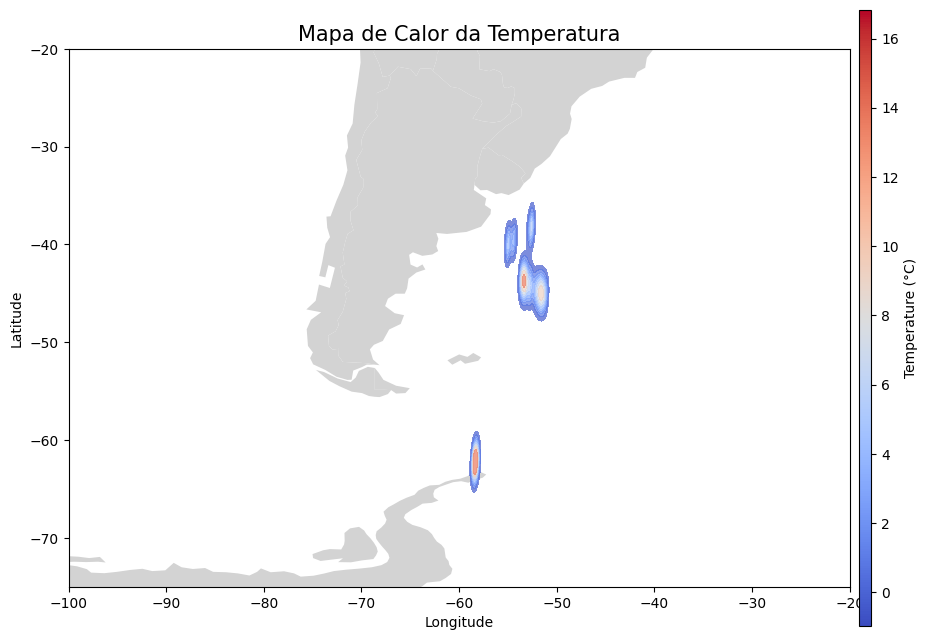

In [12]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.colors import Normalize

def plot_heatmap(file_path, lat_min, lat_max, lon_min, lon_max):
    """
    Lê um arquivo CSV com dados de temperatura e localização, e plota um mapa de calor
    com manchas de temperatura em uma região específica.
    
    :param file_path: Caminho para o arquivo CSV com dados.
    :param lat_min: Latitude mínima para o recorte.
    :param lat_max: Latitude máxima para o recorte.
    :param lon_min: Longitude mínima para o recorte.
    :param lon_max: Longitude máxima para o recorte.
    """
    try:
        # Carrega os dados do CSV
        df = pd.read_excel(file_path)
        
        # Converte para um GeoDataFrame
        gdf = gpd.GeoDataFrame(df, 
                               geometry=gpd.points_from_xy(df['longitude: Longitude [deg]'], df['latitude: Latitude [deg]']),
                               crs='EPSG:4326')
        
        # Filtra os dados de acordo com os limites
        filtered_gdf = gdf.cx[lon_min:lon_max, lat_min:lat_max]
        
        # Cria o gráfico
        fig, ax = plt.subplots(1, 1, figsize=(12, 8))
        
        # Carrega um mapa base do mundo
        world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
        world.plot(ax=ax, color='lightgrey')

        # Cria uma grade para interpolação KDE
        lon_grid = pd.Series(filtered_gdf['longitude: Longitude [deg]'])
        lat_grid = pd.Series(filtered_gdf['latitude: Latitude [deg]'])
        
        # Plota o mapa de calor usando KDE
        sns.kdeplot(data=filtered_gdf, x='longitude: Longitude [deg]', y='latitude: Latitude [deg]',
                    cmap='coolwarm', fill=True, ax=ax, alpha=0.7, thresh=0.1)

        # Define os limites do mapa
        ax.set_xlim(lon_min, lon_max)
        ax.set_ylim(lat_min, lat_max)
        
        # Adiciona título e rótulos
        ax.set_title('Mapa de Calor da Temperatura', fontsize=15)
        ax.set_xlabel('Longitude')
        ax.set_ylabel('Latitude')
        
        # Adiciona a barra de cores
        sm = plt.cm.ScalarMappable(cmap='coolwarm', norm=Normalize(vmin=filtered_gdf['t090C: Temperature [ITS-90, deg C]'].min(), vmax=filtered_gdf['t090C: Temperature [ITS-90, deg C]'].max()))
        cbar = fig.colorbar(sm, ax=ax, orientation='vertical', pad=0.01, aspect=50)
        cbar.set_label('Temperature (°C)')
        
        # Mostra o gráfico
        plt.show()
        
    except Exception as e:
        print(f"Ocorreu um erro ao processar o arquivo: {e}")

# Exemplo de uso
file_path = 'arquivo_combinado.xlsx'

# Defina os limites do recorte
lat_min, lat_max = -75, -20
lon_min, lon_max = -100, -20
plot_heatmap(file_path, lat_min, lat_max, lon_min, lon_max)


In [13]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.colors import Normalize
from shapely.geometry import Point

def plot_oil_spill_heatmap(file_path, lat_min, lat_max, lon_min, lon_max):
    """
    Lê um arquivo Excel com dados ambientais e plota um mapa de calor para identificar
    possíveis manchas de petróleo com base em baixos níveis de oxigênio e altos níveis
    de salinidade.

    :param file_path: Caminho para o arquivo Excel com dados.
    :param lat_min: Latitude mínima para o recorte.
    :param lat_max: Latitude máxima para o recorte.
    :param lon_min: Longitude mínima para o recorte.
    :param lon_max: Longitude máxima para o recorte.
    """
    try:
        # Carrega os dados do arquivo Excel
        df = pd.read_excel(file_path)

        # Verifica e ajusta os nomes das colunas, se necessário
        df.columns = df.columns.str.strip().str.replace(' ', '_')

        # Defina os nomes das colunas de interesse
        sbeox_col = 'sbeox0ML/L'
        sal_col = 'sal00'
        lat_col = 'latitude: Latitude [deg]'
        lon_col = 'longitude: Longitude [deg]'
        
        # Define critérios para identificar possíveis manchas de petróleo
        df['potential_oil_spill'] = (df[sbeox_col] < 5) & (df[sal_col] > 35)

        # Filtra os dados para possíveis manchas de petróleo
        filtered_df = df[df['potential_oil_spill']]

        # Converte para um GeoDataFrame
        gdf = gpd.GeoDataFrame(filtered_df, 
                               geometry=gpd.points_from_xy(filtered_df[lon_col], filtered_df[lat_col]),
                               crs='EPSG:4326')

        # Filtra os dados de acordo com os limites
        filtered_gdf = gdf.cx[lon_min:lon_max, lat_min:lat_max]
        
        # Cria o gráfico
        fig, ax = plt.subplots(1, 1, figsize=(12, 8))
        
        # Carrega um mapa base do mundo
        world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
        world.plot(ax=ax, color='lightgrey')

        # Plota o mapa de calor usando KDE
        sns.kdeplot(data=filtered_gdf, x=lon_col, y=lat_col,
                    cmap='coolwarm', fill=True, ax=ax, alpha=0.7, thresh=0.1)

        # Define os limites do mapa
        ax.set_xlim(lon_min, lon_max)
        ax.set_ylim(lat_min, lat_max)
        
        # Adiciona título e rótulos
        ax.set_title('Mapa de Calor de Possíveis Manchas de Petróleo', fontsize=15)
        ax.set_xlabel('Longitude')
        ax.set_ylabel('Latitude')
        
        # Adiciona a barra de cores
        # O mapeamento de cores foi ajustado para refletir a densidade dos pontos
        sm = plt.cm.ScalarMappable(cmap='coolwarm', norm=Normalize(vmin=0, vmax=1))
        cbar = fig.colorbar(sm, ax=ax, orientation='vertical', pad=0.01, aspect=50)
        cbar.set_label('Densidade de Pontos')
        
        # Mostra o gráfico
        plt.show()
        
    except Exception as e:
        print(f"Ocorreu um erro ao processar o arquivo: {e}")

# Exemplo de uso
file_path = 'dOP38_001.xlsx'

# Defina os limites do recorte
lat_min, lat_max = -75, -20
lon_min, lon_max = -100, -20
plot_oil_spill_heatmap(file_path, lat_min, lat_max, lon_min, lon_max)


Ocorreu um erro ao processar o arquivo: 'sbeox0ML/L'


In [ ]:
df = pd.read_excel('arquivo_combinado.xlsx')
df

,scan: Scan Count,timeJ: Julian Days,"prDM: Pressure, Digiquartz [db]","depSM: Depth [salt water, m]","t090C: Temperature [ITS-90, deg C]","t190C: Temperature, 2 [ITS-90, deg C]",c0S/m: Conductivity [S/m],"c1S/m: Conductivity, 2 [S/m]","sbeox0ML/L: Oxygen, SBE 43 [ml/l]","sbeox1ML/L: Oxygen, SBE 43, 2 [ml/l]",...,dz/dtM: Descent Rate [m/s],"potemp090C: Potential Temperature [ITS-90, deg C]","potemp190C: Potential Temperature, 2 [ITS-90, deg C]","density00: Density [density, Kg/m^3]","density11: Density, 2 [density, Kg/m^3]","sigma-θ00: Density [sigma-theta, Kg/m^3]","sigma-θ11: Density, 2 [sigma-theta, Kg/m^3]",oxsatML/L: Oxygen Saturation [ml/l],"svCM: Sound Velocity [Chen-Millero, m/s]",flag
0,621,326.8309130000000096,5.0490000000000004,4.9989999999999997,-0.3055000000000000,-0.3039000000000000,2.8156949999999998,2.8160539999999998,7.6292000000000000,7.3249100000000000,...,0.6140000000000000,-0.3057000000000000,-0.3041000000000000,1027.4755999999999858,1027.4779000000000906,27.4514999999999993,27.4538000000000011,8.1569299999999991,1446.7000000000000455,0
1,621,326.8309130000000096,5.0490000000000004,4.9989999999999997,-0.3055000000000000,-0.3039000000000000,2.8156949999999998,2.8160539999999998,7.6292000000000000,7.3249100000000000,...,0.6140000000000000,-0.3057000000000000,-0.3041000000000000,1027.4755999999999858,1027.4779000000000906,27.4514999999999993,27.4538000000000011,8.1569299999999991,1446.7000000000000455,0
2,659,326.8309310000000210,6.0579999999999998,5.9980000000000002,-0.3207000000000000,-0.3151000000000000,2.8144749999999998,2.8154990000000000,7.6281699999999999,7.2839700000000001,...,0.6230000000000000,-0.3209000000000000,-0.3153000000000000,1027.4811999999999443,1027.4870000000000800,27.4523000000000010,27.4579999999999984,8.1602399999999999,1446.6500000000000909,0
3,659,326.8309310000000210,6.0579999999999998,5.9980000000000002,-0.3207000000000000,-0.3151000000000000,2.8144749999999998,2.8154990000000000,7.6281699999999999,7.2839700000000001,...,0.6230000000000000,-0.3209000000000000,-0.3153000000000000,1027.4811999999999443,1027.4870000000000800,27.4523000000000010,27.4579999999999984,8.1602399999999999,1446.6500000000000909,0
4,694,326.8309469999999806,7.0679999999999996,7.0010000000000003,-0.2959000000000000,-0.2796000000000000,2.8168190000000002,2.8182760000000000,7.6397300000000001,7.2797900000000002,...,0.6940000000000000,-0.2961000000000000,-0.2798000000000000,1027.4872000000000298,1027.4873999999999796,27.4533999999999985,27.4537000000000013,8.1546699999999994,1446.7799999999999727,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29655,39371,16.7224350000000008,1025.1969999999998890,1014.9980000000000473,3.9811999999999999,3.9822000000000002,3.2306949999999999,3.2311550000000002,5.6105099999999997,5.3446100000000003,...,0.8550000000000000,3.9041000000000001,3.9051000000000000,1031.8713999999999942,1031.8747000000000753,27.1508000000000003,27.1541999999999994,7.3062600000000000,1482.3699999999998909,0
29656,39395,16.7224469999999990,1026.2100000000000364,1016.0040000000000191,3.9782000000000002,3.9792000000000001,3.2304780000000002,3.2309130000000001,5.6098900000000000,5.3479500000000000,...,0.9810000000000000,3.9011000000000000,3.9020000000000001,1031.8764000000001033,1031.8795000000000073,27.1510999999999996,27.1542999999999992,7.3067900000000003,1482.3699999999998909,0
29657,39395,16.7224469999999990,1026.2100000000000364,1016.0040000000000191,3.9782000000000002,3.9792000000000001,3.2304780000000002,3.2309130000000001,5.6098900000000000,5.3479500000000000,...,0.9810000000000000,3.9011000000000000,3.9020000000000001,1031.8764000000001033,1031.8795000000000073,27.1510999999999996,27.1542999999999992,7.3067900000000003,1482.3699999999998909,0
29658,39735,16.7226110000000006,1027.2219999999999800,1017.0040000000000191,3.9722000000000000,3.9735000000000000,3.2299950000000002,3.2304979999999999,5.6017000000000001,5.3439699999999997,...,0.1050000000000000,3.89500

In [14]:
import pandas as pd

def load_data_from_excel(file_path):
    """
    Carrega dados de um arquivo Excel e retorna um DataFrame.
    
    :param file_path: Caminho para o arquivo .xlsx
    :return: DataFrame com os dados carregados
    """
    try:
        df = pd.read_excel(file_path)
        return df
    except Exception as e:
        print(f"Ocorreu um erro ao ler o arquivo: {e}")
        return None

# Exemplo de uso
file_path = 'dOP38_001.xlsx'
df = load_data_from_excel(file_path)


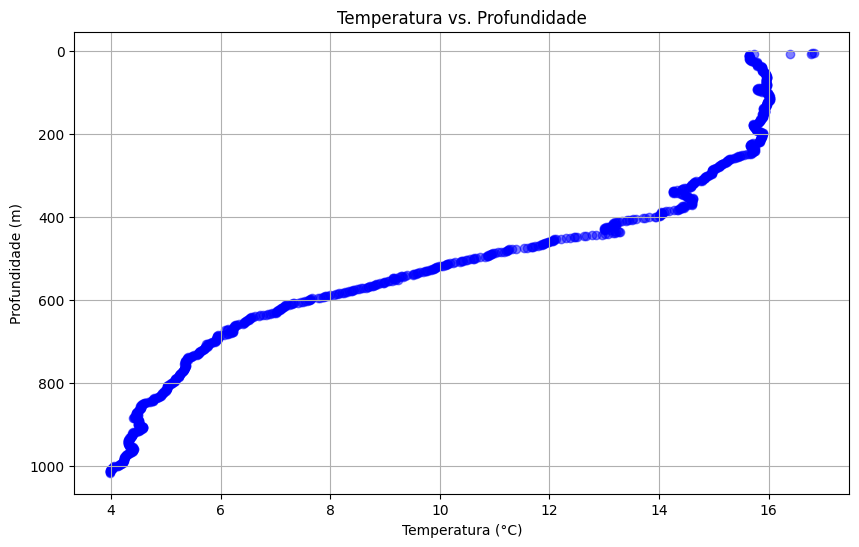

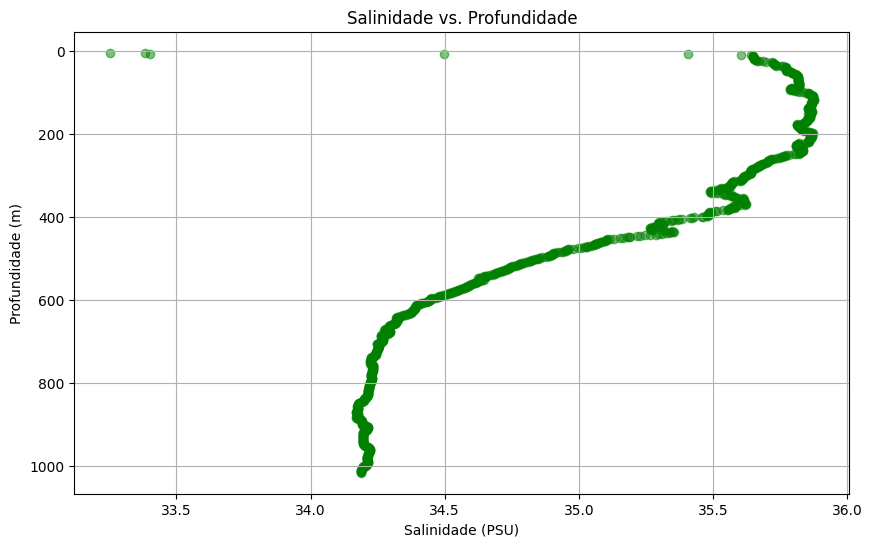

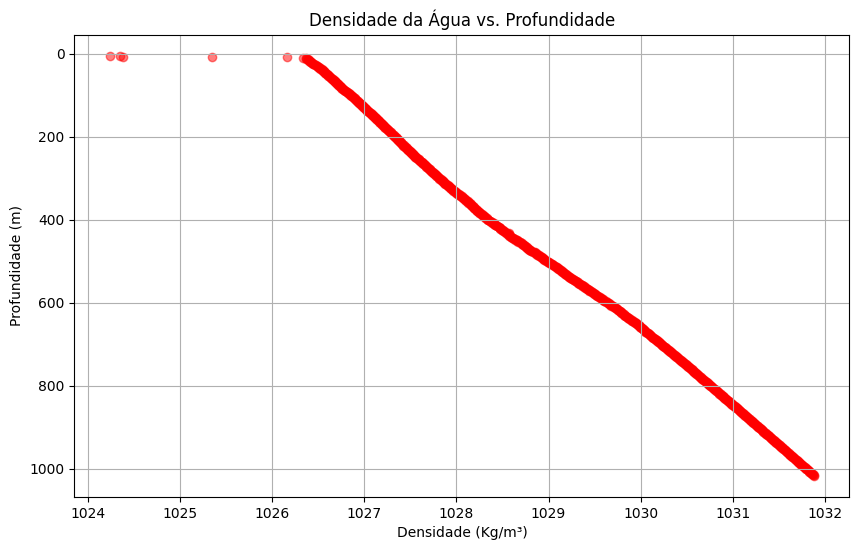

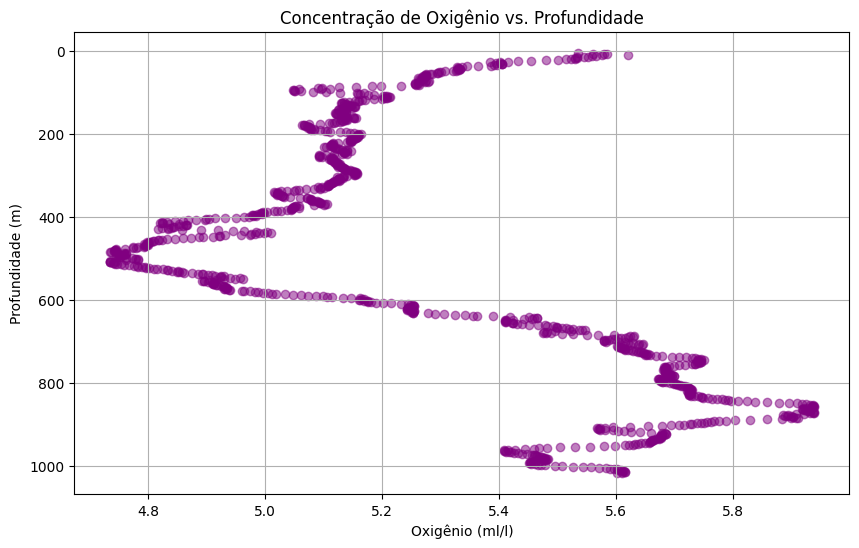

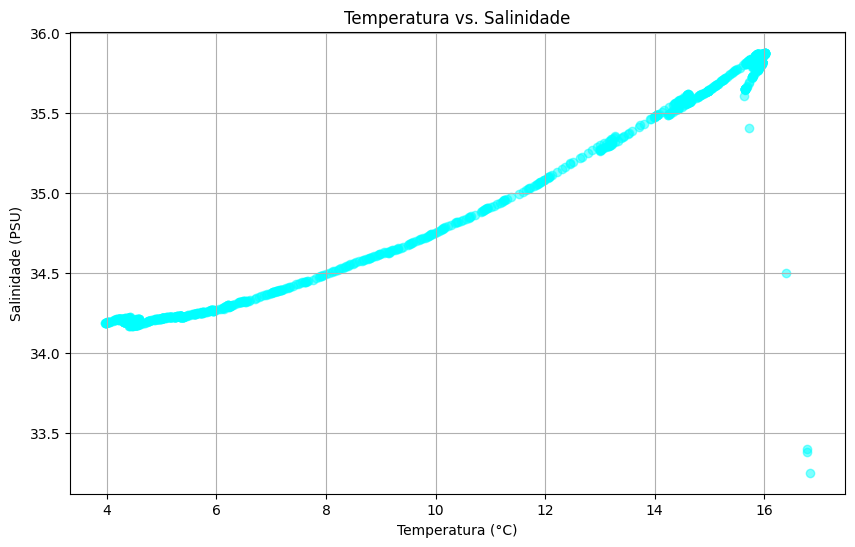

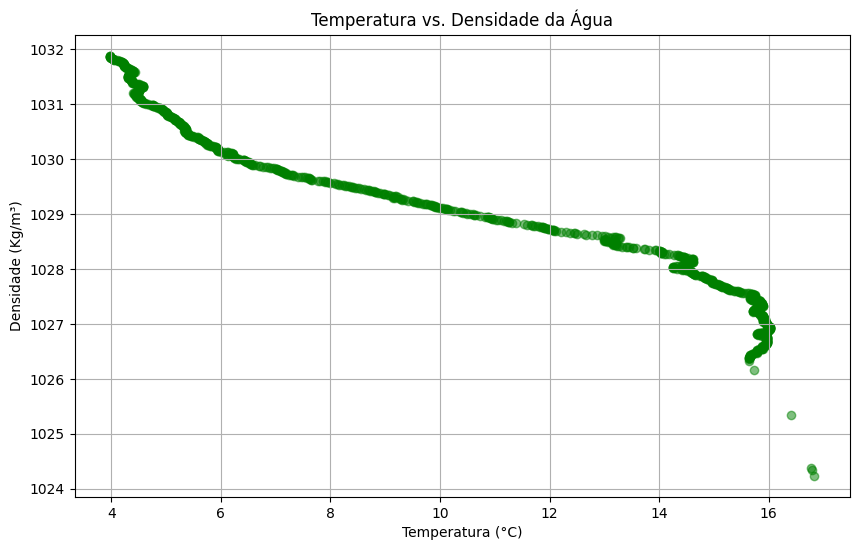

c:\Users\Indicium\AppData\Local\Programs\Python\Python38\lib\site-packages\pandas\plotting\_matplotlib\core.py:509: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = self.plt.figure(figsize=self.figsize)


<Figure size 1200x800 with 0 Axes>

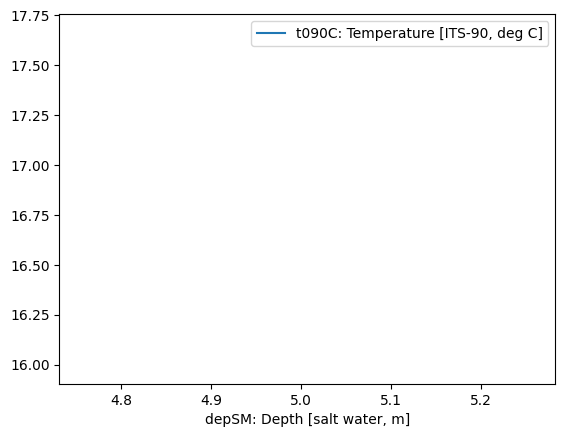

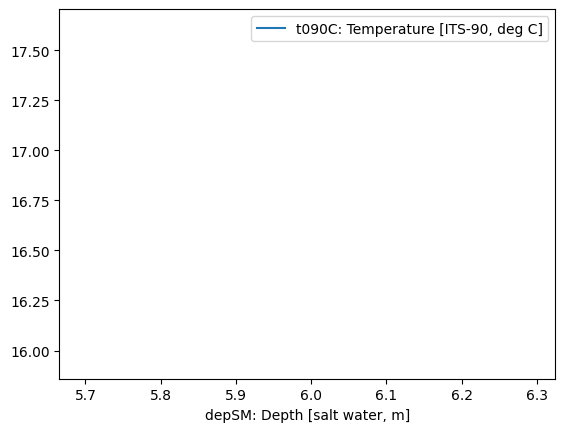

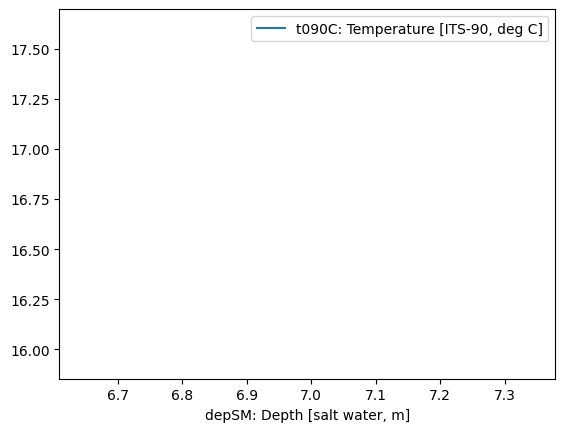

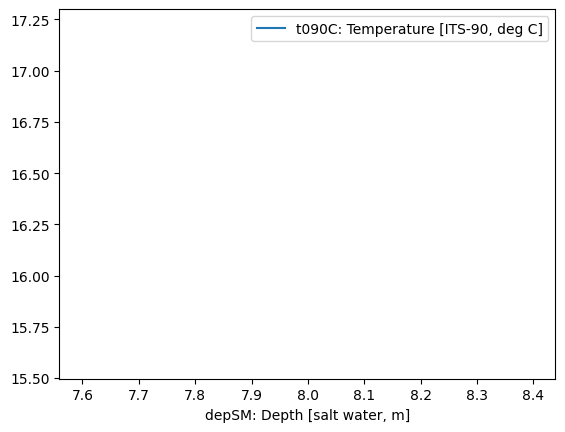

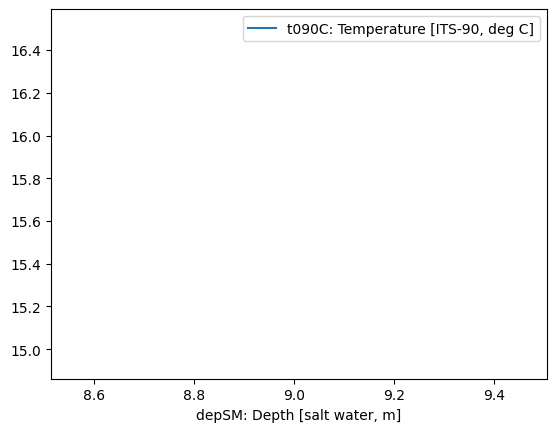

...

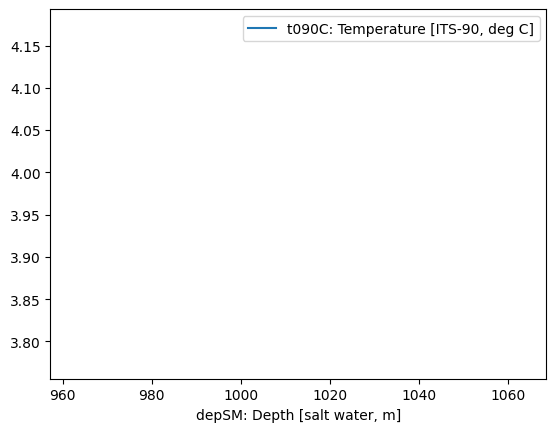

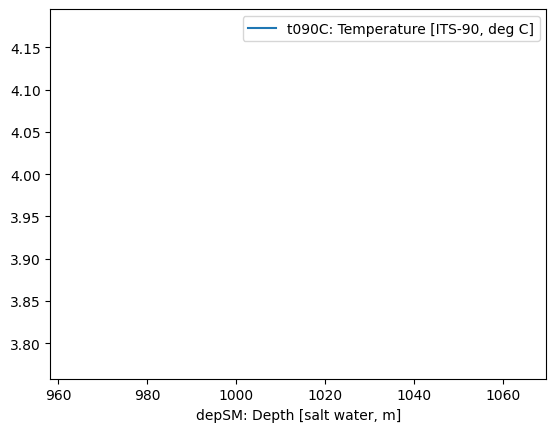

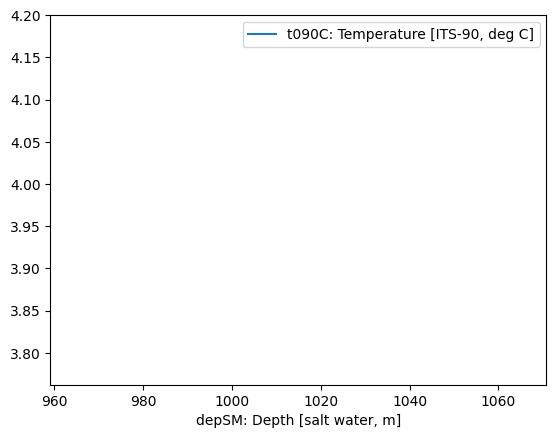

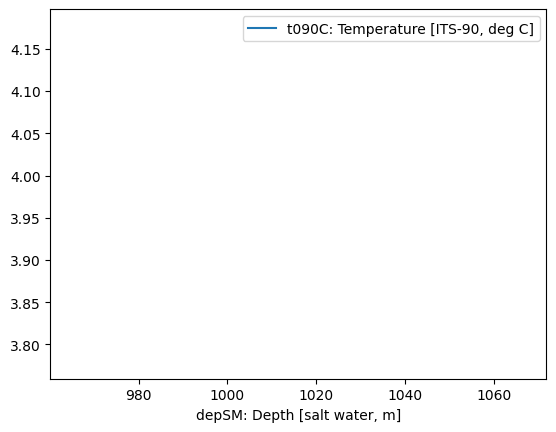

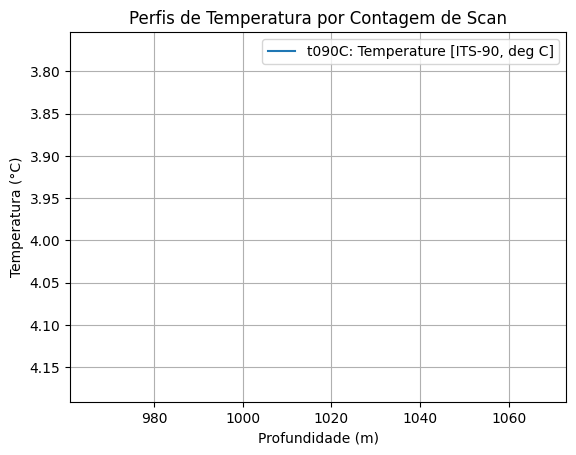

In [16]:
import matplotlib.pyplot as plt
import seaborn as sns

def plot_temp_vs_depth(df):
    plt.figure(figsize=(10, 6))
    plt.scatter(df['t090C: Temperature [ITS-90, deg C]'], df['depSM: Depth [salt water, m]'], c='blue', alpha=0.5)
    plt.xlabel('Temperatura (°C)')
    plt.ylabel('Profundidade (m)')
    plt.title('Temperatura vs. Profundidade')
    plt.gca().invert_yaxis()
    plt.grid(True)
    plt.show()

def plot_salinity_vs_depth(df):
    plt.figure(figsize=(10, 6))
    plt.scatter(df['sal00: Salinity [PSU]'], df['depSM: Depth [salt water, m]'], c='green', alpha=0.5)
    plt.xlabel('Salinidade (PSU)')
    plt.ylabel('Profundidade (m)')
    plt.title('Salinidade vs. Profundidade')
    plt.gca().invert_yaxis()
    plt.grid(True)
    plt.show()

def plot_density_vs_depth(df):
    plt.figure(figsize=(10, 6))
    plt.scatter(df['density00: Density [density, Kg/m^3]'], df['depSM: Depth [salt water, m]'], c='red', alpha=0.5)
    plt.xlabel('Densidade (Kg/m³)')
    plt.ylabel('Profundidade (m)')
    plt.title('Densidade da Água vs. Profundidade')
    plt.gca().invert_yaxis()
    plt.grid(True)
    plt.show()

def plot_oxygen_vs_depth(df):
    plt.figure(figsize=(10, 6))
    plt.scatter(df['sbeox0ML/L: Oxygen, SBE 43 [ml/l]'], df['depSM: Depth [salt water, m]'], c='purple', alpha=0.5)
    plt.xlabel('Oxigênio (ml/l)')
    plt.ylabel('Profundidade (m)')
    plt.title('Concentração de Oxigênio vs. Profundidade')
    plt.gca().invert_yaxis()
    plt.grid(True)
    plt.show()

def plot_temp_vs_salinity(df):
    plt.figure(figsize=(10, 6))
    plt.scatter(df['t090C: Temperature [ITS-90, deg C]'], df['sal00: Salinity [PSU]'], c='cyan', alpha=0.5)
    plt.xlabel('Temperatura (°C)')
    plt.ylabel('Salinidade (PSU)')
    plt.title('Temperatura vs. Salinidade')
    plt.grid(True)
    plt.show()

def plot_temp_density_scatter(df):
    plt.figure(figsize=(10, 6))
    plt.scatter(df['t090C: Temperature [ITS-90, deg C]'], df['density00: Density [density, Kg/m^3]'], c='green', alpha=0.5)
    plt.xlabel('Temperatura (°C)')
    plt.ylabel('Densidade (Kg/m³)')
    plt.title('Temperatura vs. Densidade da Água')
    plt.grid(True)
    plt.show()

def plot_depth_temp_profiles(df):
    plt.figure(figsize=(12, 8))
    df.groupby('scan: Scan Count').plot(x='depSM: Depth [salt water, m]', y='t090C: Temperature [ITS-90, deg C]', kind='line')
    plt.ylabel('Temperatura (°C)')
    plt.xlabel('Profundidade (m)')
    plt.title('Perfis de Temperatura por Contagem de Scan')
    plt.gca().invert_yaxis()
    plt.grid(True)
    plt.show()

# Exemplo de uso das funções
plot_temp_vs_depth(df)
plot_salinity_vs_depth(df)
plot_density_vs_depth(df)
plot_oxygen_vs_depth(df)
plot_temp_vs_salinity(df)
plot_temp_density_scatter(df)
plot_depth_temp_profiles(df)


C:\Users\Indicium\AppData\Local\Temp\ipykernel_3432\3929415077.py:34: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


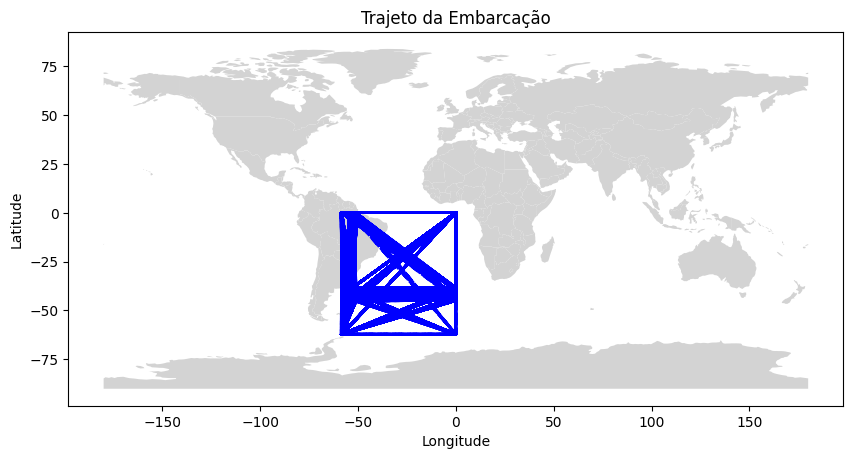

Gráfico do trajeto salvo em trajeto_embarcacao_tracejado.png


In [ ]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
from shapely.geometry import Point, LineString

def plot_vessel_trajectory_from_file(file_path, latitude_column, longitude_column, output_file):
    """
    Plota o trajeto da embarcação a partir de um arquivo .xlsx com dados de latitude e longitude.

    :param file_path: Caminho para o arquivo .xlsx
    :param latitude_column: Nome da coluna de latitude no arquivo
    :param longitude_column: Nome da coluna de longitude no arquivo
    :param output_file: Caminho para o arquivo de saída da imagem do gráfico
    """
    try:
        # Ler o arquivo .xlsx
        df = pd.read_excel(file_path)

        # Verificar se as colunas de latitude e longitude estão presentes
        if latitude_column not in df.columns or longitude_column not in df.columns:
            print(f"As colunas '{latitude_column}' e/ou '{longitude_column}' não foram encontradas no arquivo.")
            return

        # Criar um GeoDataFrame a partir dos dados
        gdf = gpd.GeoDataFrame(df, geometry=gpd.points_from_xy(df[longitude_column], df[latitude_column]))

        # Criar uma linha a partir dos pontos de latitude e longitude
        trajectory_line = LineString(gdf.geometry)

        # Criar um GeoDataFrame para a linha do trajeto
        trajectory_gdf = gpd.GeoDataFrame(geometry=[trajectory_line])

        # Criar o mapa
        world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

        # Plotar o mapa
        fig, ax = plt.subplots(figsize=(10, 10))
        world.plot(ax=ax, color='lightgrey')
        trajectory_gdf.plot(ax=ax, color='blue', linestyle='--', linewidth=2)  # Linha tracejada
        ax.set_title('Trajeto da Embarcação')
        plt.xlabel('Longitude')
        plt.ylabel('Latitude')

        # Salvar o gráfico
        plt.savefig(output_file)
        plt.show()
        print(f"Gráfico do trajeto salvo em {output_file}")

    except Exception as e:
        print(f"Erro ao processar o arquivo: {e}")

# Nome das colunas de latitude e longitude no arquivo
latitude_column = 'latitude: Latitude [deg]'  # Substitua pelo nome correto da coluna de latitude
longitude_column = 'longitude: Longitude [deg]'  # Substitua pelo nome correto da coluna de longitude

# Caminho para o arquivo .xlsx
file_path = 'arquivo_combinado.xlsx'# Substitua pelo caminho do seu arquivo



# Nome do arquivo de saída da imagem
output_file = 'trajeto_embarcacao_tracejado.png'  # Nome do arquivo de saída da imagem

plot_vessel_trajectory_from_file(file_path, latitude_column, longitude_column, output_file)


In [ ]:
import glob
import os

def count_excel_files(directory):
    """
    Conta o número de arquivos .xlsx em um diretório.

    :param directory: Caminho para o diretório a ser verificado
    :return: Número de arquivos .xlsx encontrados
    """
    # Verifica se o diretório existe
    if not os.path.isdir(directory):
        print(f"O diretório {directory} não existe.")
        return 0
    
    # Encontrar todos os arquivos .xlsx no diretório
    excel_files = glob.glob(os.path.join(directory, '*.xlsx'))

    # Contar o número de arquivos encontrados
    file_count = len(excel_files)
    print(f"Número de arquivos .xlsx encontrados: {file_count}")

    return file_count

# Exemplo de uso
directory_path = "./"  # Substitua pelo seu diretório
count_excel_files(directory_path)


Número de arquivos .xlsx encontrados: 22


22

In [ ]:
column_names = [
        'scan: Scan Count', 'timeJ: Julian Days', 'prDM: Pressure, Digiquartz [db]',
        'depSM: Depth [salt water, m]', 't090C: Temperature [ITS-90, deg C]', 
        't190C: Temperature, 2 [ITS-90, deg C]', 'c0S/m: Conductivity [S/m]',
        'c1S/m: Conductivity, 2 [S/m]', 'sbeox0ML/L: Oxygen, SBE 43 [ml/l]',
        'sbeox1ML/L: Oxygen, SBE 43, 2 [ml/l]', 'sal00: Salinity [PSU]', 
        'sal11: Salinity, 2 [PSU]', 'flSP: Fluorescence, Seapoint',
        'latitude: Latitude [deg]', 'longitude: Longitude [deg]',
        'dz/dtM: Descent Rate [m/s]', 'depSM: Depth [salt water, m]',
        'potemp090C: Potential Temperature [ITS-90, deg C]',
        'potemp190C: Potential Temperature, 2 [ITS-90, deg C]',
        'sal00: Salinity [PSU]', 'sal11: Salinity, 2 [PSU]',
        'density00: Density [density, Kg/m^3]', 'density11: Density, 2 [density, Kg/m^3]',
        'sigma-θ00: Density [sigma-theta, Kg/m^3]', 'sigma-θ11: Density, 2 [sigma-theta, Kg/m^3]',
        'oxsatML/L: Oxygen Saturation [ml/l]', 'svCM: Sound Velocity [Chen-Millero, m/s]',
        'flag'
    ]


In [ ]:
fd = pd.read_excel('arquivo_combinado.xlsx')
l = fd.columns.to_list()
len(l) - len(column_names)

-3

In [ ]:
print(len(column_names))

28
